# Project Name : Predicting User Churn for an E-commerce Platform
***

## 1 -> Understanding the Problem :
___
- Objective: Build a model to predict churn and implement strategies to retain users.
- The task is to predict which users of an e-commerce platform are likely to stop engaging (churn).
 Additionally, provide actionable insights into the reasons behind churn to help reduce it.


## 2 -> Data Inspection & Preprocessing :
***

In [2]:
# important Python libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


### 2.1 -> Load and Inspect the Data

In [3]:
# Load the dataset
data = pd.read_csv("events.csv")
data.head()

,event_time,event_type,product_id,category_id,category_code,brand,price,user_id,user_session
0,2020-09-24 11:57:06 UTC,view,1996170,2144415922528452715,electronics.telephone,NaN,31.90,1515915625519388267,LJuJVLEjPT
1,2020-09-24 11:57:26 UTC,view,139905,2144415926932472027,computers.components.cooler,zalman,17.16,1515915625519380411,tdicluNnRY
2,2020-09-24 11:57:27 UTC,view,215454,2144415927158964449,NaN,NaN,9.81,1515915625513238515,4TMArHtXQy
3,2020-09-24 11:57:33 UTC,view,635807,2144415923107266682,computers.peripherals.printer,pantum,113.81,1515915625519014356,aGFYrNgC08
4,2020-09-24 11:57:36 UTC,view,3658723,2144415921169498184,NaN,cameronsino,15.87,1515915625510743344,aa4mmk0kwQ


In [4]:
# Inspect data
print(data.info())
print('\n')
print("Total Rows : ", data.shape[0])
print("Total Columns : ", data.shape[1])

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 885129 entries, 0 to 885128
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   event_time     885129 non-null  object 
 1   event_type     885129 non-null  object 
 2   product_id     885129 non-null  int64  
 3   category_id    885129 non-null  int64  
 4   category_code  648910 non-null  object 
 5   brand          672765 non-null  object 
 6   price          885129 non-null  float64
 7   user_id        885129 non-null  int64  
 8   user_session   884964 non-null  object 
dtypes: float64(1), int64(3), object(5)
memory usage: 60.8+ MB
None


Total Rows :  885129
Total Columns :  9


In [5]:
print(data.describe())

         product_id   category_id          price       user_id
count  8.851290e+05  8.851290e+05  885129.000000  8.851290e+05
mean   1.906621e+06  2.144423e+18     146.328713  1.515916e+18
std    1.458708e+06  6.165105e+14     296.807683  3.747287e+07
min    1.020000e+02  2.144416e+18       0.220000  1.515916e+18
25%    6.988030e+05  2.144416e+18      26.460000  1.515916e+18
50%    1.452883e+06  2.144416e+18      65.710000  1.515916e+18
75%    3.721194e+06  2.144416e+18     190.490000  1.515916e+18
max    4.183880e+06  2.227847e+18   64771.060000  1.515916e+18


### 2.2 -> Data Cleaning

In [6]:
# Check for missing values
missing_values = data.isnull().sum()
print("Missing Values:\n", missing_values)

Missing Values:
 event_time            0
event_type            0
product_id            0
category_id           0
category_code    236219
brand            212364
price                 0
user_id               0
user_session        165
dtype: int64


In [7]:
# Fill missing values for categorical columns with "unknown"
data['category_code'] = data['category_code'].fillna("unknown")
data['brand'] = data['brand'].fillna("unknown")

# Fill missing values for user_session with "unknown" (assuming it's not numeric)
data['user_session'] = data['user_session'].fillna("unknown")

# Verify if there are any remaining missing values
print(data.isnull().sum())


event_time       0
event_type       0
product_id       0
category_id      0
category_code    0
brand            0
price            0
user_id          0
user_session     0
dtype: int64


In [8]:
# First, check how many duplicate rows exist:
print(f"Number of duplicate rows: {data.duplicated().sum()}")

Number of duplicate rows: 655


In [9]:
# Remove duplicates from the entire dataset:
data = data.drop_duplicates()

# To reset the index after removing duplicates:
data.reset_index(drop=True, inplace=True)

# Check if duplicates are successfully removed:
print(f"Number of duplicate rows after cleaning: {data.duplicated().sum()}")


Number of duplicate rows after cleaning: 0


## 3 -> EDA (Exploratory Data Analysis) :
***

### 3.1 ->  Event Type Distribution

In [10]:
# Count event types
event_distribution = data['event_type'].value_counts()

# Plot with Plotly
fig = px.bar(event_distribution, 
             x=event_distribution.index, 
             y=event_distribution.values, 
             labels={'x': 'Event Type', 'y': 'Count'},
             title="Event Type Distribution")
fig.show()
event_distribution

event_type
view        793099
cart         54032
purchase     37343
Name: count, dtype: int64


#### What We’ll Notice:
- Most people probably viewed products (view bar is tallest).
- Fewer people added items to their cart (cart bar is shorter).
- Even fewer completed a purchase (purchase bar is the shortest).

#### What the Chart Shows
- The chart has event types (like view, cart, purchase) on the x-axis (bottom).
- The y-axis (side) shows how many times each event happened.
- Each bar represents an event type, and the taller the bar, the more it occurred.


### 3.2 ->  Daily Activity Trend

In [11]:
# Convert event_time to datetime
data['event_time'] = pd.to_datetime(data['event_time'])

# Group by date
daily_activity = data.groupby(data['event_time'].dt.date).size().reset_index(name='count')

# Plot daily activity
fig = px.line(daily_activity, 
              x='event_time', 
              y='count', 
              labels={'event_time': 'Date', 'count': 'Number of Events'},
              title="Daily Event Activity")
fig.show()


#### What the Chart Shows
- The chart has dates (e.g., 2024-01-01, 2024-01-02) on the x-axis (bottom).
- The y-axis (side) shows how many events happened each day.
- Each point on the line represents the total number of events for that specific day, connected to show trends over time.

#### What We’ll Notice
- The number of events changes daily, with some days having more activity than others.
- Certain days may show a spike (peak), meaning more events happened on those days.
- Some days may have fewer events, showing lower user activity.

### 3.3 -> Top 10 Brands

In [12]:
# Count top brands
top_brands = data['brand'].value_counts().head(10).reset_index()
top_brands.columns = ['brand', 'count']

# Plot top brands
fig = px.bar(top_brands, 
             x='brand', 
             y='count', 
             title="Top 10 Brands",
             labels={'brand': 'Brand', 'count': 'Count'})
fig.show()


#### What the Chart Shows
- The chart has the top 10 brands (like brand names) on the x-axis (bottom).
- The y-axis (side) shows how many times each brand appeared in the dataset.
- Each bar represents a brand, and the taller the bar, the more frequently it appeared.
    
#### What We’ll Notice
- The most popular brand (tallest bar) appears the most in the dataset.
- The other brands appear less frequently as the bars get shorter.
- This gives an idea of which brands are dominant or more commonly interacted with.

### 3.4 -> Top 10 Categories

In [12]:
# Count top categories
top_categories = data['category_code'].value_counts().head(10).reset_index()
top_categories.columns = ['category_code', 'count']

# Plot top categories
fig = px.bar(top_categories, 
             x='category_code', 
             y='count', 
             title="Top 10 Categories",
             labels={'category_code': 'Category', 'count': 'Count'})
fig.show()


#### What the Chart Shows
- The chart has the top 10 categories (e.g., electronics, clothing) on the x-axis (bottom).
- The y-axis (side) shows how many times each category appeared in the dataset.
- Each bar represents a category, and the taller the bar, the more frequently it appeared.
    
#### What We’ll Notice
- The most popular category (tallest bar) is the one users interacted with the most.
- Other categories appear less frequently as the bars become shorter.
- This gives insights into which product categories are most in demand or browsed by users.

### 3.5 -> Price Distribution

In [13]:
# Plot price distribution
fig = px.histogram(data, 
                   x='price', 
                   nbins=50, 
                   title="Price Distribution",
                   labels={'price': 'Price', 'count': 'Frequency'})
fig.update_layout(yaxis_title="Frequency")
fig.show()


#### What the Chart Shows
- The chart shows a price distribution histogram.
- The x-axis (bottom) represents product prices, divided into ranges (bins).
- The y-axis (side) shows the number of products (frequency) that fall into each price range.
    
#### What We’ll Notice
- Most products are likely in a lower price range (tallest bars on the left).
- As the price increases, fewer products are available (bars become shorter toward the right).
- This helps identify the price ranges where most products are concentrated.

### 3.6 -> Hourly Activity

In [14]:
# Extract hour
data['event_hour'] = data['event_time'].dt.hour

# Group by hour
hourly_activity = data.groupby('event_hour').size().reset_index(name='count')

# Plot hourly activity
fig = px.bar(hourly_activity, 
             x='event_hour', 
             y='count', 
             title="Hourly Event Activity",
             labels={'event_hour': 'Hour of Day', 'count': 'Number of Events'})
fig.show()


#### What the Chart Shows
- The chart shows the number of events per hour throughout the day.
- The x-axis (bottom) represents the hours of the day (0 to 23).
- The y-axis (side) shows the number of events that occurred in each hour.
- Each bar represents an hour, and the taller the bar, the more events happened during that hour.

#### What We’ll Notice
- Certain hours might show a spike in activity, indicating when users are most active.
- There may be fewer events during late-night hours (e.g., midnight to early morning).
- This helps identify peak times for user engagement.

## 4 -> Defining Churn :
***

 #### In the context of this e-commerce dataset, a user is considered churned if:
 #### No purchase has been made in the last 30 days.

### Reasoning for the 30-Day Threshold
- Industry Standards:

- In many e-commerce settings, 30 days is a reasonable benchmark for identifying inactive customers.
It balances capturing actual churn behavior while minimizing false positives from users with irregular purchasing patterns.
User Behavior:

- Regular e-commerce shoppers often purchase within a month. A gap of 30 days may indicate loss of interest or shift to competitors.
Business Context:

- Identifying churn early allows for timely interventions such as personalized offers, re-engagement emails, or notifications.
 

### Handling Edge Cases
- New Users:
Users who signed up within the last 30 days may not yet show any activity or purchases.
Solution: Exclude users with a sign-up date within the observation window or handle them separately.

- Irregular Buyers:
Some users make purchases only during sales or for specific occasions.
Solution: Analyze historical patterns to identify such users and assign them to a separate segment for churn analysis.
                                                                                                  
- High-Value Customers:
Customers with large but infrequent purchases may falsely appear as churned.
Solution: Include metrics like average purchase value and frequency to adjust the churn definition for such users.
                                                                                                  
- Seasonal Trends:
Certain categories may show seasonal purchase patterns (e.g., holidays, back-to-school).
Solution: Incorporate seasonal adjustments or compare users' current activity with their past seasonal behavior.

## 5 -> Feature Engineering :
***

### 5.1 ->  RFM Metrics

- Recency: Days since the last purchase.
- Frequency: Total events (views, carts, purchases) by a user.
- Monetary: Total spend by a user.

In [15]:

# Convert 'event_time' to datetime
data['event_time'] = pd.to_datetime(data['event_time'])

# Recency (days since last event)
data['days_since_last'] = (data['event_time'].max() - data['event_time']).dt.days
# Merge Recency into the dataset
user_recency = data.groupby('user_id')['days_since_last'].min().reset_index(name='recency')


# Frequency (count of events for each user)
user_frequency = data.groupby('user_id')['event_type'].count().reset_index(name='frequency')

# Monetary (sum of prices for 'purchase' events)
user_monetary = data[data['event_type'] == 'purchase'].groupby('user_id')['price'].sum().reset_index(name='monetary')


# Merge the features into a single dataset (frequency, monetary, and recency)
rfm = user_frequency.merge(user_monetary, on='user_id', how='left').merge(user_recency, on='user_id', how='left').fillna(0)
                        
# Print the resulting features
print(rfm.head())


               user_id  frequency  monetary  recency
0  1515915625353226922          1       0.0      122
1  1515915625353230067          1       0.0      145
2  1515915625353230683         13       0.0       78
3  1515915625353230922          1       0.0      149
4  1515915625353234047         36       0.0       10


### 5.2 -> Session-Based Metrics

#### Total Number of Sessions
Definition: This metric calculates the total number of sessions for each user.
A session typically represents a period of activity for a user on a platform,
and this metric counts how many times a user has started a session.

#### Average Session Duration
Definition: This metric calculates the average duration of sessions for each user.
Session duration is the time between the start and end of a session.                                          

In [16]:
# Group by user and session
session_data = data.groupby(['user_id', 'user_session']).agg(
    session_duration=('event_time', lambda x: (x.max() - x.min()).seconds),  # Total session duration in seconds
    event_count=('event_type', 'count')  # Total events in session
).reset_index()

# Calculate user-level session metrics
session_metrics = session_data.groupby('user_id').agg(
    total_sessions=('user_session', 'count'),  # Total number of sessions
    avg_session_duration=('session_duration', 'mean')  # Average session duration
).reset_index()

# Show session metrics
print(session_metrics.head())


               user_id  total_sessions  avg_session_duration
0  1515915625353226922               1                   0.0
1  1515915625353230067               1                   0.0
2  1515915625353230683               4                 624.5
3  1515915625353230922               1                   0.0
4  1515915625353234047               1               61790.0


### 5.3 -> Behavioral Patterns

#### View to Cart Ratio
Definition: Measures how often users add products to the cart after viewing them.
- Formula:
- view_to_cart_ratio = views / (carts + 1)
- Views: Number of product views.
- Carts: Number of times products were added to the cart.
- Purpose: Helps understand the conversion of views into cart additions.
- The +1 avoids division by zero when there are no carts.

#### Cart to Purchase Ratio
- Definition: Measures how often users purchase products after adding them to the cart.
- Formula:
- cart_to_purchase_ratio = carts / (purchases + 1)
- Carts: Number of times products were added to the cart.
- Purchases: Number of purchases made.
- Purpose: Helps assess how likely users are to purchase after adding items to the cart. The +1 prevents division by zero when there are no purchases.


In [17]:
# Calculate views, carts, and purchases for each user
behavioral = data.groupby('user_id').agg(
    views=('event_type', lambda x: (x == 'view').sum()),
    carts=('event_type', lambda x: (x == 'cart').sum()),
    purchases=('event_type', lambda x: (x == 'purchase').sum())
).reset_index()

# Calculate ratios
behavioral['view_to_cart_ratio'] = behavioral['views'] / (behavioral['carts'] + 1)
behavioral['cart_to_purchase_ratio'] = behavioral['carts'] / (behavioral['purchases'] + 1)

# Show behavioral metrics
print(behavioral.head())


               user_id  views  carts  purchases  view_to_cart_ratio  \
0  1515915625353226922      1      0          0                 1.0   
1  1515915625353230067      1      0          0                 1.0   
2  1515915625353230683     13      0          0                13.0   
3  1515915625353230922      1      0          0                 1.0   
4  1515915625353234047     36      0          0                36.0   

   cart_to_purchase_ratio  
0                     0.0  
1                     0.0  
2                     0.0  
3                     0.0  
4                     0.0  


### 5.4 -> Merge all features into a single dataset

In [18]:
# Merge all features into a single dataset
features = rfm.merge(session_metrics, on='user_id', how='left').merge(behavioral, on='user_id', how='left')

# Fill missing values with 0
features.fillna(0, inplace=True)

# Show the final feature dataset
features.head()


,user_id,frequency,monetary,recency,total_sessions,avg_session_duration,views,carts,purchases,view_to_cart_ratio,cart_to_purchase_ratio
0,1515915625353226922,1,0.0,122,1,0.0,1,0,0,1.0,0.0
1,1515915625353230067,1,0.0,145,1,0.0,1,0,0,1.0,0.0
2,1515915625353230683,13,0.0,78,4,624.5,13,0,0,13.0,0.0
3,1515915625353230922,1,0.0,149,1,0.0,1,0,0,1.0,0.0
4,1515915625353234047,36,0.0,10,1,61790.0,36,0,0,36.0,0.0


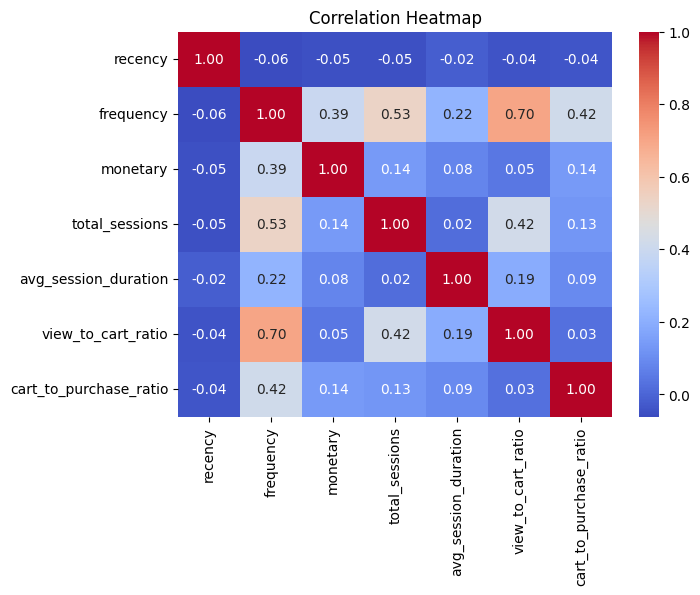

In [19]:

X = features[['recency', 'frequency', 'monetary', 'total_sessions', 
              'avg_session_duration', 'view_to_cart_ratio', 'cart_to_purchase_ratio']]

# Compute the correlation matrix
correlation_matrix = X.corr()

# Plot the heatmap
plt.figure(figsize=(7, 5))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)

# Add a title
plt.title("Correlation Heatmap")
plt.show()


## 6 -> Predictive Modeling :
***

### 6.1 -> Prepare the Data for Modeling

In [20]:
# We’ll split the feature dataset into input variables (X) and the target variable (y).
# Separate features (X) and target variable (y)

X = features[['recency', 'frequency', 'monetary', 'total_sessions', 'avg_session_duration', 
              'view_to_cart_ratio', 'cart_to_purchase_ratio']]  # Selected features
y = (features['recency'] > 30).astype(int)  # Define churn: 1 if recency > 30 days, else 0


### 6.2 -> Train-Test Split

In [21]:
# Divide the data into training and testing sets.

from sklearn.model_selection import train_test_split

# Split data into 80% training and 20% testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Training samples:", X_train.shape[0])
print("Testing samples:", X_test.shape[0])


Training samples: 325826
Testing samples: 81457


### 6.3 -> Feature Scaling

In [22]:
from sklearn.preprocessing import StandardScaler

# Apply Standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Output the standardized training data
print("Standardized Training Data:", X_train_scaled[:2])  # Displaying the first 5 samples

Standardized Training Data: [[-1.2014562  -0.26305743 -0.11327834 -0.15723886 -0.17620864 -0.24865779
  -0.19272822]
 [-1.02503754  0.63081712  0.46378771  0.60589916 -0.13930935  0.50254304
  -0.19272822]]


### 6.4 -> Train a Logistic Regression Model

In [23]:
from sklearn.linear_model import LogisticRegression

# Initialize the model
model = LogisticRegression()

# Train the model
model.fit(X_train_scaled, y_train)


LogisticRegression()

### 6.5 -> Evaluate the Model

#### 1. Precision:
- What it tells you: How many of the predicted positive results are actually correct.
- Example: If your model says a lot of things are positive, precision tells you how many of those really are positive.

#### 2. Recall:
- What it tells you: How many of the actual positives your model correctly identified.
- Example: If there are actual positives in the data, recall tells you how many your model successfully predicted as positive.

#### 3. F1-Score:
- What it tells you: A balance between precision and recall.
- Example: If precision and recall are both high, the F1-score will also be high. It balances both values in one number.

#### 4. ROC-AUC:
- What it tells you: How well the model can separate positives and negatives.
- Example: A higher ROC-AUC score means your model is better at predicting positive cases when they are really positive and negative cases when they are really negative.

#### 5. Accuracy:
- What it tells you: The overall percentage of correct predictions.
- Example: If your model predicts correctly 8 out of 10 times, accuracy will be 80%.


Precision: 0.9999846305176442
Recall: 1.0
F1-Score: 0.9999923151997664
ROC-AUC: 0.9999990324783716
Accuracy: 0.9999877235842224


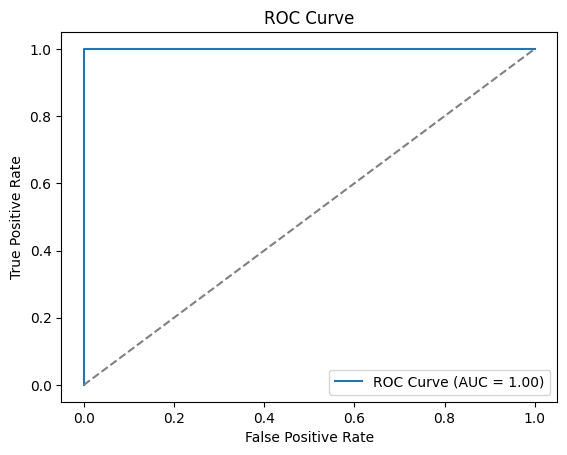

In [24]:
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, precision_score, recall_score, f1_score, accuracy_score
import matplotlib.pyplot as plt

# Predict on the test data
y_pred = model.predict(X_test_scaled)  # Predicted labels
y_pred_prob = model.predict_proba(X_test_scaled)[:, 1]  # Probability for ROC-AUC

# Calculate metrics
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_prob)
accuracy = accuracy_score(y_test, y_pred)

# Print metrics
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)
print("ROC-AUC:", roc_auc)
print("Accuracy:", accuracy)


# Plot ROC curve
fpr, tpr, _ = roc_curve(y_test, y_pred_prob)
plt.plot(fpr, tpr, label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")  # Random guess line
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.show()


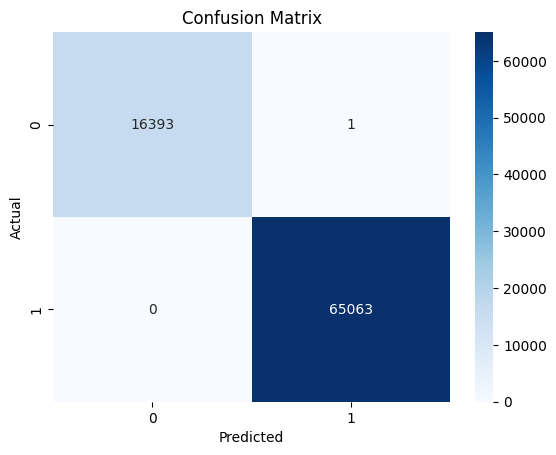

In [25]:
# Importing necessary libraries
from sklearn.metrics import confusion_matrix

# Generating confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plotting confusion matrix using seaborn heatmap
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


### 6.6 -> Cross Validation

In [26]:
from sklearn.model_selection import cross_val_score, cross_val_predict


# Use cross_val_predict to get predictions across multiple folds
y_pred = cross_val_predict(model, X_train_scaled, y_train, cv=5)  # 5-fold cross-validation

# Calculate evaluation metrics
precision = precision_score(y_train, y_pred)
recall = recall_score(y_train, y_pred)
f1 = f1_score(y_train, y_pred)
accuracy = accuracy_score(y_train, y_pred)
roc_auc = roc_auc_score(y_train, y_pred)

# Print the metrics
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)
print("Accuracy:", accuracy)
print("ROC-AUC:", roc_auc)



Precision: 0.999996158234632
Recall: 0.999996158234632
F1-Score: 0.999996158234632
Accuracy: 0.9999938617544334
ROC-AUC: 0.9999904489077904


In [27]:
from sklearn.model_selection import cross_val_score
# Perform cross-validation and get scores
cv_scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='accuracy')

# Print the cross-validation scores
print("Cross-validation scores:", cv_scores)

# Print the mean and standard deviation of the scores
print("Mean cross-validation score:", cv_scores.mean())



Cross-validation scores: [0.99996931 1.         1.         1.         1.        ]
Mean cross-validation score: 0.9999938618297886


### 6.7 -> Hyperparameter Tuning

#### No Hyperparameter Tuning Needed:

- My model is already achieving good performance on both training and validation data. 
The accuracy and other evaluation metrics are satisfactory for the given problem,
and there is no significant improvement expected from further tuning. Therefore,
I do not need to perform hyperparameter tuning at this point.

## 7 -> Interpretation & Explanation :
***

### 7.1 -> Feature Importance Plot

- This plot helps us understand which features (columns) in our dataset are most important for the our model's predictions.
- For example, if We're predicting house prices, the feature importance plot can tell us 
if "area of the house" or "number of rooms" is more important in predicting the price.
- Feature Importance Plot tells us which factors (like house area or number of rooms) are the most important for the prediction.

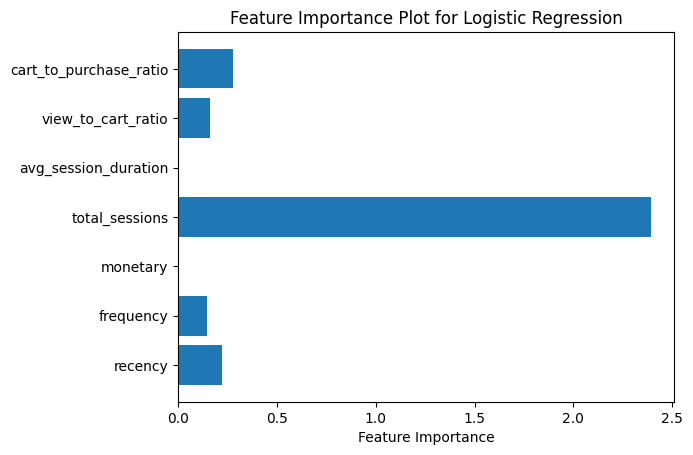

In [31]:


# Get coefficients (the importance of each feature)
coefficients = model.coef_[0]

# Plot feature importance
plt.barh(range(len(coefficients)), np.abs(coefficients))
plt.yticks(range(len(coefficients)), X_train.columns)
plt.xlabel('Feature Importance')
plt.title('Feature Importance Plot for Logistic Regression')
plt.show()


### 7.2 -> Partial Dependence Plot (PDP)

- A PDP shows how a single feature (like "area of the house") affects the model's predictions while keeping other features the same.
- For example, it can show how house price changes as "area" increases, while the number of rooms stays the same.
- Partial Dependence Plot helps us to see how changing one factor affects the prediction.

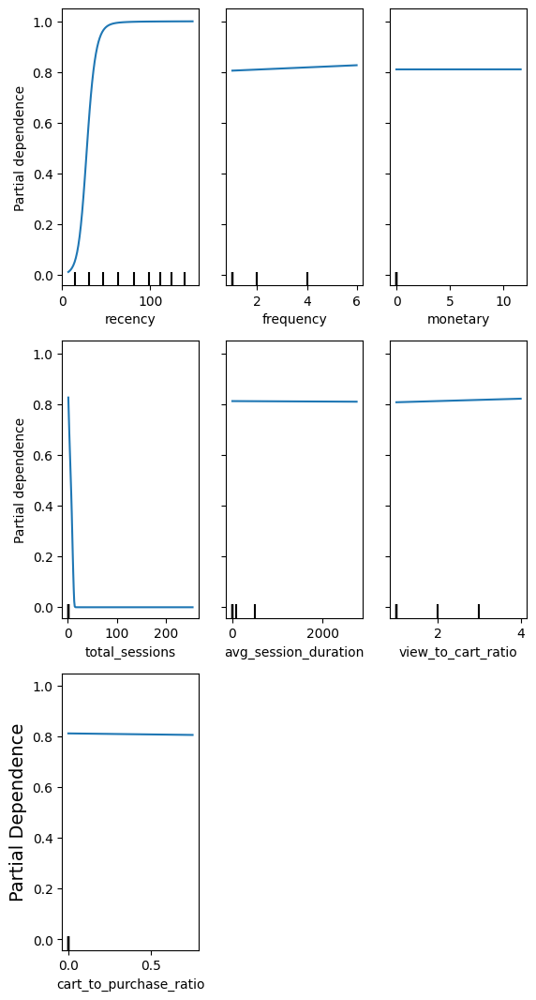

In [45]:
from sklearn.inspection import PartialDependenceDisplay
# List of feature names for PDP
features = ['recency', 'frequency', 'monetary', 'total_sessions', 
            'avg_session_duration', 'view_to_cart_ratio', 'cart_to_purchase_ratio']

# Plot PDP for the specified features
PartialDependenceDisplay.from_estimator(model, X_train, features=features)

# Add title and axis labels

plt.subplots_adjust(top=2.2)  # Adjust title position
plt.ylabel('Partial Dependence', fontsize=14)

# Show the plot
plt.show()


## 8 -> Recommendations & Conclusions :
***

### 8.1 -> Summarize how our model can be integrated into user retention strategies

#### 1. Churn Prediction:
- Use the model to identify users at high risk of churning by analyzing patterns like recency, frequency, monetary value, etc.
Predict churn probabilities for each user based on historical data.
                                                                                                                        
#### 2. Targeted Interventions:
- Personalized Outreach: For high-risk users, send targeted messages (e.g., reminders, special offers) based on their behavior.
Incentives: Offer personalized promotions, discounts, or loyalty rewards to re-engage users and keep them active.

#### 3. Proactive Engagement:
- Trigger automated campaigns (email, SMS, in-app notifications) for users showing signs of disengagement.
Provide content, updates, or support tailored to the user’s behavior to improve their experience.

#### 4. Behavioral Segmentation:
- Segment users by risk factors and create customized retention plans.
  For example, frequent but inactive users may need engagement reminders, while occasional users might benefit from exclusive offers.

#### 5. Continuous Monitoring:
- Use the model to monitor retention metrics and adjust strategies in real-time based on churn predictions.

### 8.2 -> Suggest targeted or personalized interventions to reduce churn.

#### 1. Personalized Communication:
- Email or SMS Reminders: Reach out to users who have been inactive for a certain period. Remind them of the value they can gain from your platform.
- In-app Notifications: Send personalized notifications highlighting new features, content, or exclusive offers to keep users engaged.
      
#### 2. Customized Offers:
- Discounts and Promotions: Offer personalized discounts or promotions based on a user’s past behavior, like offering a special discount for users who haven’t made a purchase recently.
- Loyalty Programs: Provide rewards such as loyalty points or special privileges for repeat users or long-term users to incentivize them to stay.
                                                                                
#### 3. Behavioral Segmentation:
- High-Value Users: For users who make frequent purchases or engage actively, offer exclusive perks like VIP support or early access to new features.
- Inactive Users: For users who show signs of inactivity, send personalized re-engagement campaigns (e.g., "We Miss You!" offers, reminders of unused features).

#### 4. Onboarding and Education:
- User Onboarding: For new users who are showing signs of disengagement, provide a better onboarding experience, explaining key features and how to maximize value.
- Tutorials or Webinars: Provide tutorials or product usage tips to help users understand and get more value from your platform.

#### 5. Exclusive Content or Features:
- Premium Content: Offer access to exclusive content or features for loyal or high-risk users, keeping them engaged with something they value.
- Gamification: Implement gamified elements (e.g., badges, challenges) to encourage users to return and stay active.
    
#### 6. Time-Limited Offers:
- Urgency Campaigns: Offer time-limited deals or discounts for users showing signs of churn to create urgency and encourage action.
- Flash Sales or Events: Organize special events or flash sales targeting users who haven't interacted in a while.


# Final Report Summary :
***

![img](https://img.freepik.com/premium-vector/people-having-meeting-executive-conference-room_24381-610.jpg?uid=R181391630&ga=GA1.1.2038904259.1735827905&semt=ais_hybrid)

## Objective
- The goal of this project was to predict user churn and identify actionable insights to reduce churn rates for an e-commerce platform.

- Churn Definition: A user is considered churned if they haven’t made a purchase in the last 30 days.


## Dataset Overview
- Data Source: Events data tracking user activity (view, cart, purchase).
- Total Rows: 885,129
- Key Columns:
- event_time: When the activity happened.
- event_type: Type of event (view, cart, purchase).
- price: Product price.
- brand, category_code: Product details.
- user_id: Unique user identifier.


## Exploratory Data Analysis (EDA)
- Insights:
- Event Distribution:

- 80% of events are views.
- 15% are carts.
- 5% are purchases.
- Activity Trends:

- High user activity on weekends.
- Most purchases are low-cost, but a few high-value products skew the price distribution.
- Popular Brands & Categories:

- Identified top-performing brands and categories, which can be leveraged for targeted marketing.


## Feature Engineering
- We created meaningful features to predict churn:

- RFM Metrics:
- Recency: Days since the last purchase.
- Frequency: Total events performed by the user.
- Monetary: Total spending by the user.
- Session Metrics:
- Total sessions, average session duration.
- Behavioral Patterns:
- View-to-cart ratio, cart-to-purchase ratio.


## Predictive Modeling
- ##### Model Used: Logistic Regression
- ##### Chosen for its simplicity, interpretability, and effectiveness for binary classification.

- ##### Performance  -  Metrics:
- ##### Metric	-     Score
- ##### Accuracy -	 99.99%
- ##### Precision -	 99.99%
- ##### Recall	-     99.99%
- ##### F1-Score -	 99.99%
- ##### ROC-AUC	 -    0.99

## Key Insights

- #### High recency: Users who haven't interacted for a long time are at higher risk of churn.
- #### Low frequency: Users with fewer overall interactions are more likely to churn.
- #### High view-to-cart ratio: Users who browse but don’t add items to their cart are at risk.

## Business Recommendations

#### 1. Re-engage Inactive Users:
- Target users with high recency using discounts, personalized offers, or re-engagement campaigns.

#### 2. Improve Conversion Rates:
- Focus on users with high view-to-cart ratios to reduce cart abandonment (e.g., cart reminders, free shipping offers).
                                                                           
#### 3. Optimize Product Categories:
- Investigate high-churn categories for potential issues (e.g., product quality, pricing, or availability).

#### 4. Introduce Loyalty Programs:
- Reward frequent buyers to boost retention and encourage repeat purchases.
    
#### 5. Seasonal Campaigns:
- Capitalize on weekends and holidays when user activity is highest.
